In [1]:
import pandas as pd
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

sns.set(font_scale=1.5)
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# Modelling The Data

In [2]:
# calling in the data saved from EDA
df = pd.read_csv('/Users/KStamp/Desktop/Katie Stamp - DSI20 - LDN/Cleaned Datasets/chitest.csv', index_col=['Unnamed: 0'])

After EDA we have 44 columns and 57990 observations remaining.

In [3]:
df.head()

,year,month,day,extended,country,region,vicinity,crit1,crit2,crit3,...,property,ishostkid,ransom,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related,date,geometry
39,1970,1,31,0,160,5,0,1,1,0,...,0,0.0,0.0,0,1,1,1,1,1970-01-31,POINT (120.331618 15.675051)
169,1970,4,2,0,160,5,1,1,1,0,...,0,0.0,0.0,0,1,1,1,1,1970-04-02,POINT (120.54187 15.185916)
226,1970,4,25,0,209,10,0,1,1,1,...,1,0.0,0.0,1,0,1,1,1,1970-04-25,POINT (28.689863 41.106178)
253,1970,5,4,0,158,3,0,1,1,1,...,0,0.0,0.0,1,0,1,1,1,1970-05-04,POINT (-57.63561 -25.282773)
364,1970,6,26,0,603,8,0,1,1,1,...,1,0.0,0.0,0,0,1,1,1,1970-06-26,POINT (-7.312045 55.011562)


In [4]:
df.columns

Index(['year', 'month', 'day', 'extended', 'country', 'region', 'vicinity',
       'crit1', 'crit2', 'crit3', 'doubtterr', 'multiple', 'success',
       'suicide', 'attacktype1', 'attacktype2', 'attacktype3', 'targtype1',
       'targsubtype1', 'natlty1', 'targtype2', 'targsubtype2', 'targtype3',
       'targsubtype3', 'gname', 'weaptype1', 'weapsubtype1', 'weaptype2',
       'weapsubtype2', 'weaptype3', 'weapsubtype3', 'weaptype4',
       'weapsubtype4', 'nkill', 'property', 'ishostkid', 'ransom', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related', 'date', 'geometry'],
      dtype='object')

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 57990 entries, 39 to 181687
Data columns (total 44 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   year          57990 non-null  int64  
 1   month         57990 non-null  int64  
 2   day           57990 non-null  int64  
 3   extended      57990 non-null  int64  
 4   country       57990 non-null  int64  
 5   region        57990 non-null  int64  
 6   vicinity      57990 non-null  int64  
 7   crit1         57990 non-null  int64  
 8   crit2         57990 non-null  int64  
 9   crit3         57990 non-null  int64  
 10  doubtterr     57990 non-null  float64
 11  multiple      57990 non-null  float64
 12  success       57990 non-null  int64  
 13  suicide       57990 non-null  int64  
 14  attacktype1   57990 non-null  int64  
 15  attacktype2   57990 non-null  float64
 16  attacktype3   57990 non-null  float64
 17  targtype1     57990 non-null  int64  
 18  targsubtype1  57990 non-

In [6]:
# geometry and date are columns which are repeated elsewhere, so we drop these
df.drop(['geometry', 'date'], axis=1, inplace=True)

In [7]:
# checking for null values
df.isnull().sum()

year            0
month           0
day             0
extended        0
country         0
region          0
vicinity        0
crit1           0
crit2           0
crit3           0
doubtterr       0
multiple        0
success         0
suicide         0
attacktype1     0
attacktype2     0
attacktype3     0
targtype1       0
targsubtype1    0
natlty1         0
targtype2       0
targsubtype2    0
targtype3       0
targsubtype3    0
gname           0
weaptype1       0
weapsubtype1    0
weaptype2       0
weapsubtype2    0
weaptype3       0
weapsubtype3    0
weaptype4       0
weapsubtype4    0
nkill           0
property        0
ishostkid       0
ransom          0
INT_LOG         0
INT_IDEO        0
INT_MISC        0
INT_ANY         0
related         0
dtype: int64

In [8]:
# Our models won't be able to run with negative values we'll change the 'unknown' categorical variables
# to unused positive values
df.replace(-99, value=333, inplace=True)

In [9]:
df.replace(-9, value=333, inplace=True)

In [10]:
df.ransom.replace(-10, value=444, inplace=True)

In [11]:
df.ransom.unique()

array([  0.,   1., 444., 333.])

# Reviewing The 'City' Feature

In order to get as much detail as possible I wanted to look into city names to give specifics on where the attacks occured, at the moment we have just under 15,000 unique city names.

I reviewed if there were cities that could be combined or if spelling mistakes were creating multiple cities. This was not the case. There are a 14,893 different cities.

If we dummify the city column it would create an extra 14,893 columns in our dataset and therefore create too much noise for the modelling.

We won't use this in our model as it doesn't give any specific details that can be grouped or clustered as there are too many options.

In [12]:
gtd = pd.read_csv('/Users/KStamp/Desktop/Katie Stamp - DSI20 - LDN/Cleaned Datasets/gtd.csv', index_col=['Unnamed: 0'])

In [13]:
# checking for unique cities
np. set_printoptions(threshold=np. inf)
gtd.city.unique()

array(['Bamban', 'Mabalacat City', 'Istanbul', 'Asuncion', 'Londonderry',
       'Belfast', 'Crossmaglen', 'Donostia-San Sebastian', 'Trillick',
       'Clady', 'Kinawley', 'Lisburn', 'Edendork', 'Strabane', 'Lambeg',
       'Lurgan', 'Newry', 'Eibar', 'Caledon', 'Ballymurphy, Belfast',
       'Urnieta', 'Abadiano', 'Newtownabbey', 'Keady', 'Castlewellan',
       'Dublin', 'Stewartstown', 'Cullyhanna', 'Newtownbutler', 'Moira',
       'Aldershot', 'New Delhi', 'Frevagh', 'Middletown', 'Coalisland',
       'Urguizo', 'Ballykelly', 'Andersontown, Belfast', 'Ballymoney',
       'Newtownhamilton', 'Carrickfergus', 'Isasondo', nan, 'Rosslea',
       'Craigavon', 'Dungiven', 'Silverbridge', 'Claudy', 'Lisnaskea',
       'Enniskillen', 'Creggan', 'Galdacano', 'Dungannon', 'Brussels',
       'Derry', 'Aghalane', 'Bonn', 'Armagh', 'Derrydoon', 'Paris',
       'Ballynahone', 'Belleek', 'Killeter', 'Feeny', 'El Bagre',
       'Cappagh', 'Pamplona', 'Strangford', 'Beirut', 'Forkhill',
       'Lond

In [14]:
len(gtd.city.unique())

14893

In [15]:
# checking for duplicated city names
gtd[gtd['city'].str.match('San')== True]['city'].unique()

array(['San Juan del Carare', 'Santa Rosa', 'Santurce',
       'San Vicente de Chucuri', 'San Rafael', 'San Sebastian',
       'Santiago de Compostela', 'San Luis', 'San Jose de las Flores',
       'San Rogue', 'Santoro', 'San Sabastian', 'Santa Rita',
       'Santa Marta', 'Santa Cristina de Aro', 'Santander',
       'San Salvador', 'San Juan', 'Santa Clara', 'San Miguel',
       'Santa Ana', 'Santo Domingo de Guzman', 'San Vicente',
       'San Pedro Perulapan', 'San Sebastian Salitrillo',
       'San Juan de Arama', 'San Francisco Gotera', 'San Martin',
       'Santa Tecla', 'San Agustin', 'Santa Cruz Michapa',
       'Santa Rosa de Lima', 'San Ramon', 'San Antonio Abad',
       'Santa Elena', 'San Jose Cancasque', 'San Nicolas Lempa',
       'San Marcos', 'San Antonio de la Cruz', 'San Esteban Catarina',
       'San Lorenzo', 'Santo Domingo', 'Santiago',
       'Santander de Quilichao', 'San Joaquin', 'Santa Maria',
       'San Juan Opico', 'San Fernando', 'San Ildefonso', 'San Ped

In [16]:
# dummfying city column
city_dum = pd.get_dummies(gtd['city'])
city_dum.head(5)

,Aab Kamra,Aabgarmak,Aakherobh,Aalos,Aammiq,Aankro,Aarhus,Aatpal,Ab Band,Ab Band,...,shirac,silvan,strasbourg,unknown,vilcashuaman,vinchos,yacan,zinarag,Şırnak,باغا سولا Baga-Sola
39,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
169,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
226,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
253,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
364,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [17]:
city_dum['unknown'].sum()

12

In [18]:
# dataframe to use going forward
df.columns

Index(['year', 'month', 'day', 'extended', 'country', 'region', 'vicinity',
       'crit1', 'crit2', 'crit3', 'doubtterr', 'multiple', 'success',
       'suicide', 'attacktype1', 'attacktype2', 'attacktype3', 'targtype1',
       'targsubtype1', 'natlty1', 'targtype2', 'targsubtype2', 'targtype3',
       'targsubtype3', 'gname', 'weaptype1', 'weapsubtype1', 'weaptype2',
       'weapsubtype2', 'weaptype3', 'weapsubtype3', 'weaptype4',
       'weapsubtype4', 'nkill', 'property', 'ishostkid', 'ransom', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object')

Copying the dataframe before modelling.

In [19]:
chi = df.copy()

In [20]:
# Creating categorical columns
chi[['year', 'month', 'day', 'extended', 'country', 'region', 'vicinity',
       'crit1', 'crit2', 'crit3', 'doubtterr', 'multiple', 'success',
       'suicide', 'attacktype1', 'attacktype2', 'attacktype3', 'targtype1',
       'targsubtype1', 'natlty1', 'targtype2', 'targsubtype2', 'targtype3',
       'targsubtype3', 'weaptype1', 'weapsubtype1', 'weaptype2',
       'weapsubtype2', 'weaptype3', 'weapsubtype3', 'weaptype4',
       'weapsubtype4', 'nkill', 'property', 'ishostkid', 'ransom', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related']] = chi[['year', 'month', 'day', 'extended', 'country', 'region', 'vicinity',
       'crit1', 'crit2', 'crit3', 'doubtterr', 'multiple', 'success',
       'suicide', 'attacktype1', 'attacktype2', 'attacktype3', 'targtype1',
       'targsubtype1', 'natlty1', 'targtype2', 'targsubtype2', 'targtype3',
       'targsubtype3', 'weaptype1', 'weapsubtype1', 'weaptype2',
       'weapsubtype2', 'weaptype3', 'weapsubtype3', 'weaptype4',
       'weapsubtype4', 'nkill', 'property', 'ishostkid', 'ransom', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related']].astype('category')

# Completing PCA on features

As we have a high number of features we are going to run a PCA test to see if we can reduce dimensionalty. We can avoid our algorithm being too slow because the input dimension is too high.

We start with 41 columns, what we want to see is how much of our data can be found in lesser columns, we don't want too much noise and falsely high accuracy scores.

In [21]:
gname = chi.pop('gname')

In [22]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

chi_pca = scaler.fit_transform(chi)
chi_pca = pd.DataFrame(chi_pca, columns=chi.columns)

chi_pca.head()

,year,month,day,extended,country,region,vicinity,crit1,crit2,crit3,...,weapsubtype4,nkill,property,ishostkid,ransom,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,-2.403823,-1.643156,1.759627,-0.249135,0.197891,-0.585668,-0.033301,0.035258,0.065003,-2.038750,...,0.021774,-0.254562,-0.355320,-0.058474,-1.086332,-0.247195,-0.238723,0.057277,-0.236725,-0.271577
1,-2.403823,-0.740852,-1.564614,-0.249135,0.197891,-0.585668,0.326846,0.035258,0.065003,-2.038750,...,0.021774,-0.107251,-0.355320,-0.058474,-1.086332,-0.247195,-0.238723,0.057277,-0.236725,-0.271577
2,-2.403823,-0.740852,1.071853,-0.249135,0.604127,1.081663,-0.033301,0.035258,0.065003,0.490497,...,0.021774,-0.254562,-0.345661,-0.058474,-1.086332,-0.234272,-0.251567,0.057277,-0.236725,-0.271577
3,-2.403823,-0.440084,-1.335356,-0.249135,0.181310,-1.252600,-0.033301,0.035258,0.065003,0.490497,...,0.021774,-0.180907,-0.355320,-0.058474,-1.086332,-0.234272,-0.251567,0.057277,-0.236725,-0.271577
4,-2.403823,-0.139316,1.186482,-0.249135,3.870601,0.414731,-0.033301,0.035258,0.065003,0.490497,...,0.021774,0.113716,-0.345661,-0.058474,-1.086332,-0.247195,-0.251567,0.057277,-0.236725,-0.271577


In [23]:
chi_pca.describe()

,year,month,day,extended,country,region,vicinity,crit1,crit2,crit3,...,weapsubtype4,nkill,property,ishostkid,ransom,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
count,5.799000e+04,5.799000e+04,5.799000e+04,5.799000e+04,5.799000e+04,5.799000e+04,5.799000e+04,5.799000e+04,5.799000e+04,5.799000e+04,...,5.799000e+04,5.799000e+04,5.799000e+04,5.799000e+04,5.799000e+04,5.799000e+04,5.799000e+04,5.799000e+04,5.799000e+04,5.799000e+04
mean,6.361680e-14,-7.882342e-15,-1.441341e-15,5.481018e-14,1.595328e-14,9.967248e-14,-4.173274e-15,-1.464726e-14,-2.797752e-15,-2.651973e-14,...,2.434308e-14,-9.867905e-15,-6.569126e-14,-2.116239e-14,1.110778e-13,-6.158279e-14,-4.647383e-14,1.626291e-14,-1.633284e-14,3.276210e-14
std,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,...,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00,1.000009e+00
min,-2.403823e+00,-1.643156e+00,-1.679243e+00,-2.491354e-01,-1.095434e+00,-1.919533e+00,-3.330065e-02,-2.836224e+01,-1.538389e+01,-2.038750e+00,...,-5.737207e+01,-2.545624e-01,-3.553200e-01,-5.847439e-02,-1.086332e+00,-2.471947e-01,-2.515666e-01,-4.116391e-02,-2.496982e-01,-2.715770e-01
25%,-1.006376e+00,-7.408519e-01,-8.768396e-01,-2.491354e-01,-6.228729e-01,-1.252600e+00,-3.330065e-02,3.525815e-02,6.500308e-02,4.904967e-01,...,2.177383e-02,-2.545624e-01,-3.553200e-01,-5.847439e-02,-1.086332e+00,-2.471947e-01,-2.515666e-01,-4.116391e-02,-2.496982e-01,-2.715770e-01
50%,5.381707e-01,-1.393159e-01,4.019229e-02,-2.491354e-01,7.353263e-02,-2.522015e-01,-3.330065e-02,3.525815e-02,6.500308e-02,4.904967e-01,...,2.177383e-02,-1.809067e-01,-3.456612e-01,-5.847439e-02,9.268705e-01,-2.471947e-01,-2.515666e-01,-4.116391e-02,-2.496982e-01,-2.715770e-01
75%,9.059199e-01,7.629881e-01,8.425952e-01,-2.491354e-01,3.802827e-01,1.081663e+00,-3.330065e-02,3.525815e-02,6.500308e-02,4.904967e-01,...,2.177383e-02,-3.359532e-02,-3.456612e-01,-5.847439e-02,9.268705e-01,-2.471947e-01,-2.387235e-01,-4.116391e-02,-2.367254e-01,-2.715770e-01
max,1.053020e+00,1.665292e+00,1.759627e+00,4.013881e+00,7.186817e+00,1.748596e+00,1.198954e+02,3.525815e-02,6.500308e-02,4.904967e-01,...,2.177383e-02,1.153849e+02,2.861056e+00,1.883266e+01,9.268705e-01,4.055980e+00,4.025189e+00,3.273968e+01,4.070238e+00,1.019342e+01


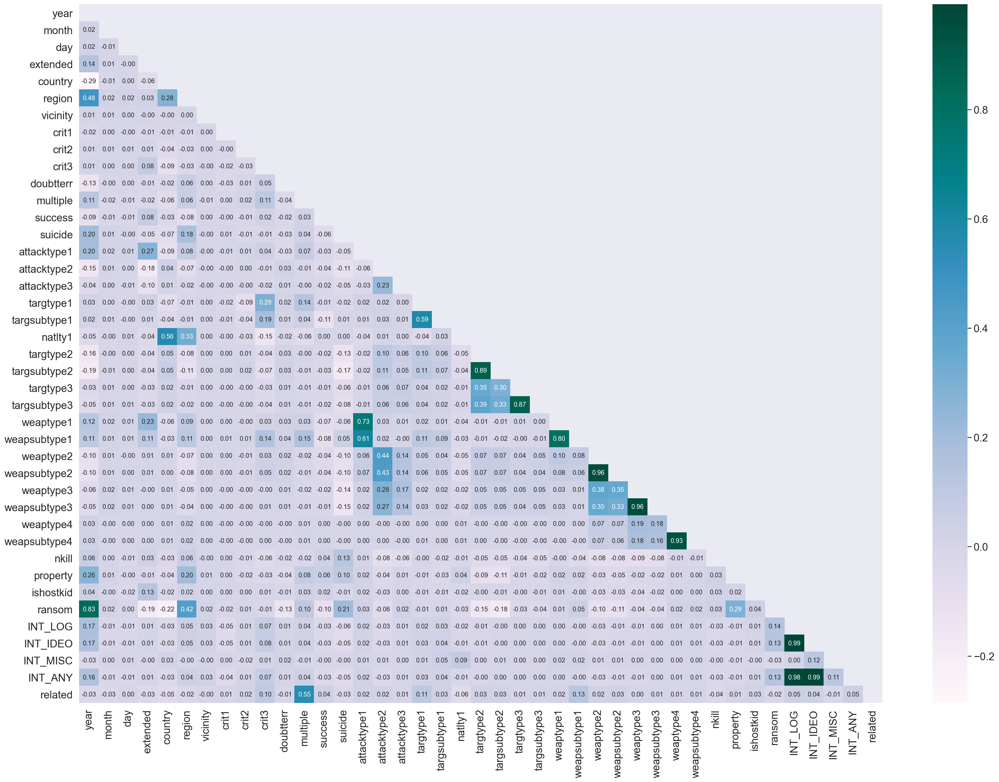

In [24]:
plt.figure(figsize=(28,20))
ax = sns.heatmap(chi_pca.cov(), annot=True, fmt='.2f', cmap='PuBuGn', mask=np.triu(np.ones_like(chi_pca.cov(), dtype=bool)))
plt.ylim([chi.shape[1], 0])
plt.show()

After we've run pca on the data set we can see that several columns such as the weaptype and weapsubtype
are highly correlated, for example we wouldn't expect a terrorist group to act with a chemical weapon and then a hand held knife.

Similiarly for attacktype1 and weaptype1, which again makes sense as we would expect attack type such as 'Bombing/Exposion' to take place with weapon type 'Explosives'.

There is also high correlation between INT_ANY / INT_IDEO AND INT_MISC which details whether the group crossed borders to plan the attack, INT_ANY is a direct result of the accumulation of the other INT columns.

Other facts to note are that year and ransom are also strongly positive correlated, meaning as the year went up the chance of ransom being "1 or yes" increased.

In [25]:
from sklearn.decomposition import PCA

pca = PCA(n_components=41)
X_pca = pca.fit_transform(chi)

In [26]:
demo_pcs = pd.DataFrame(pca.transform(chi), columns=chi.columns)
demo_pcs

,year,month,day,extended,country,region,vicinity,crit1,crit2,crit3,...,weapsubtype4,nkill,property,ishostkid,ransom,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,249.954942,2.009192,27.676970,2.954369,13.250890,43.826453,64.669585,-9.762229,-0.603088,-0.447975,...,-0.713794,-0.009771,0.867535,0.065074,0.022696,0.002076,0.200250,0.001717,-0.004467,0.001848
1,249.951600,2.010505,27.663402,2.976751,13.271532,43.818443,64.649920,-9.792222,-0.449906,0.023114,...,-0.637876,-0.037800,-0.110784,0.071854,-0.059933,0.033111,0.121496,-0.001126,-0.002485,0.001717
2,253.777392,-1.687138,6.884828,2.257225,-11.511987,-47.382433,-21.800423,-9.122691,-0.506291,-0.718906,...,0.145909,0.093787,-0.095529,0.025798,0.048750,-0.048193,0.196140,-0.003819,-0.002528,0.001254
3,245.555011,-13.454785,-34.308054,5.672705,-6.812121,-26.539438,-6.391214,-10.489368,-0.476765,-0.427035,...,0.298980,-0.005085,-0.011466,0.049151,-0.060686,0.008991,0.165763,-0.009613,-0.003669,-0.000050
4,323.495538,107.966522,390.491335,-37.425476,-39.295486,-77.158080,-115.991615,-1.334658,0.024869,0.467570,...,-0.074141,0.166576,0.799437,0.030999,0.100027,-0.058317,0.271301,-0.020737,-0.002194,-0.000751
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57985,-194.270083,-52.578800,-15.148318,-74.772800,-25.397742,-34.120092,20.639192,1.175754,1.132486,-1.635493,...,-0.736872,0.100552,0.787196,0.006625,0.202749,-0.078112,0.048465,0.004347,0.000189,0.000109
57986,-222.381770,-20.973738,265.735818,231.743320,-15.370595,145.943536,155.432223,1.170169,2.163332,-1.406732,...,-0.516704,0.131259,-0.091758,0.034265,0.128343,-0.028823,-0.026360,-0.001645,0.001626,-0.000059
57987,-212.449136,-85.127576,-134.964689,-67.325396,-43.394373,-14.373415,-47.417503,-1.760174,0.641398,-2.114983,...,0.051596,0.174993,-0.130117,-0.006218,0.047685,-0.021751,-0.079202,-0.011106,-0.001212,-0.002704
57988,-230.413744,-52.379789,145.473333,237.209871,-53.351873,-4.664360,21.316034,2.376209,2.213510,-2.193968,...,-0.622059,0.117114,-0.133030,0.030030,0.121110,-0.026935,-0.033192,-0.003107,0.001248,-0.000454


In [27]:
chi.dot(pca.components_.T).head()

,0,1,2,3,4,5,6,7,8,9,...,31,32,33,34,35,36,37,38,39,40
39,-41.652872,76.587474,223.472962,-52.249928,-336.769863,125.711318,149.942134,-16.573542,-284.946216,16.659696,...,-2.213023,5.052370,0.169024,-14.040178,0.345798,2.272697,-27.387487,-1.086499,-2.565825,-1.079026
169,-41.656214,76.588787,223.459395,-52.227546,-336.749221,125.703309,149.922469,-16.603535,-284.793034,17.130785,...,-2.137106,5.024341,-0.809296,-14.033397,0.263169,2.303732,-27.466241,-1.089342,-2.563844,-1.079157
226,-37.830422,72.891144,202.680821,-52.947072,-361.532739,34.502433,63.472125,-15.934004,-284.849419,16.388765,...,-1.353321,5.155928,-0.794040,-14.079453,0.371852,2.222428,-27.391597,-1.092035,-2.563886,-1.079620
253,-46.052803,61.123497,161.487938,-49.531592,-356.832874,55.345428,78.881335,-17.300681,-284.819893,16.680637,...,-1.200250,5.057056,-0.709977,-14.056101,0.262416,2.279612,-27.421974,-1.097829,-2.565028,-1.080924
364,31.887724,182.544804,586.287327,-92.629773,-389.316239,4.726786,-30.719066,-8.145971,-284.318259,17.575242,...,-1.573371,5.228717,0.100926,-14.074253,0.423129,2.212304,-27.316436,-1.108953,-2.563553,-1.081625


In [28]:
demo_pcs.var()

year            51655.843086
month           17517.218174
day             17117.311362
extended         9446.505238
country          5288.558269
region           4290.964078
vicinity         3614.657006
crit1            1521.842234
crit2             563.018917
crit3             310.258206
doubtterr         183.251566
multiple          171.232827
success            78.744049
suicide            75.206798
attacktype1        73.797475
attacktype2        51.499993
attacktype3        30.766871
targtype1          27.657265
targsubtype1       20.403248
natlty1            11.024310
targtype2           7.700892
targsubtype2        4.768171
targtype3           4.668168
targsubtype3        3.615217
weaptype1           3.012174
weapsubtype1        1.825213
weaptype2           1.291922
weapsubtype2        1.017262
weaptype3           0.297533
weapsubtype3        0.266589
weaptype4           0.207831
weapsubtype4        0.131439
nkill               0.103107
property            0.078385
ishostkid     

We can see alot of the variance of data is being held in the first 3 columns, being year, month and day. With related, INT_ANY and INT_MISC holding the smallest variance of data.

In [29]:
print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))

Explained variation per principal component: [4.60888011e-01 1.56293564e-01 1.52725483e-01 8.42843858e-02
 4.71860094e-02 3.82851925e-02 3.22509900e-02 1.35783059e-02
 5.02341367e-03 2.76821128e-03 1.63502219e-03 1.52778761e-03
 7.02576625e-04 6.71016277e-04 6.58441901e-04 4.59497470e-04
 2.74510706e-04 2.46765923e-04 1.82043540e-04 9.83620048e-05
 6.87095338e-05 4.25429636e-05 4.16507122e-05 3.22559891e-05
 2.68754668e-05 1.62850669e-05 1.15268902e-05 9.07629692e-06
 2.65467687e-06 2.37857991e-06 1.85432351e-06 1.17273775e-06
 9.19948874e-07 6.99374013e-07 6.56959816e-07 4.04000923e-07
 3.65975796e-07 3.03066781e-07 3.67504307e-08 2.89651616e-08
 1.10086452e-08]


In [30]:
variances = pd.DataFrame(data=pca.explained_variance_ratio_, columns=['ratio'])
variances['column'] = demo_pcs.columns

In [31]:
def func(x):
    try:
        return '{0:.3f}'.format(x)
    except:
        return x

variances = variances.applymap(func)

In [32]:
variances

,ratio,column
0,0.461,year
1,0.156,month
2,0.153,day
3,0.084,extended
4,0.047,country
5,0.038,region
6,0.032,vicinity
7,0.014,crit1
8,0.005,crit2
9,0.003,crit3


In [33]:
variances['ratio'] = pd.to_numeric(variances['ratio'])

In [34]:
variances.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41 entries, 0 to 40
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   ratio   41 non-null     float64
 1   column  41 non-null     object 
dtypes: float64(1), object(1)
memory usage: 784.0+ bytes


In [35]:
variances['ratio'].sum()

1.0

From the above dataframe, we can observe that the principal component 'year' holds 46.1% of the information whilst the rest of the data adds up to the remaining 53.9% (as we still have 41 columns).

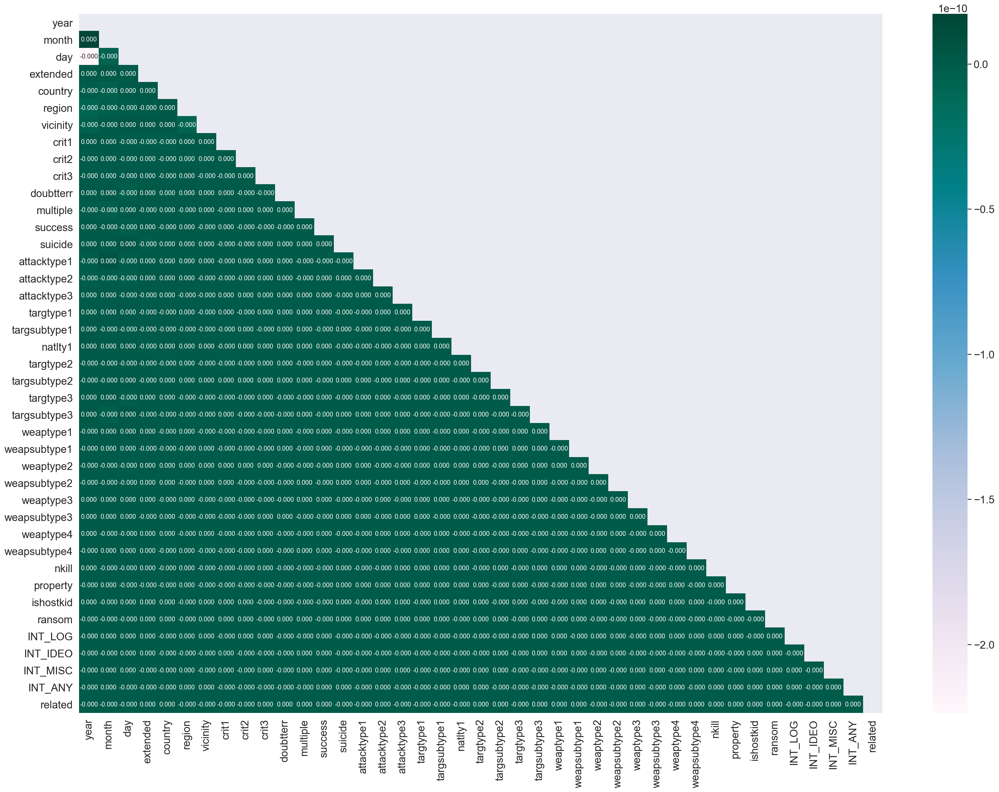

In [36]:
# heatmap to show 0% correlations after running pca on columns 
plt.figure(figsize=(28,20))
ax = sns.heatmap(demo_pcs.cov(), annot=True, fmt='.3f', cmap='PuBuGn', mask=np.triu(np.ones_like(chi_pca.cov(), dtype=bool)))
plt.show()

# PCA Explained Variances - 99% of Data

In [37]:
from scikitplot.decomposition import plot_pca_component_variance

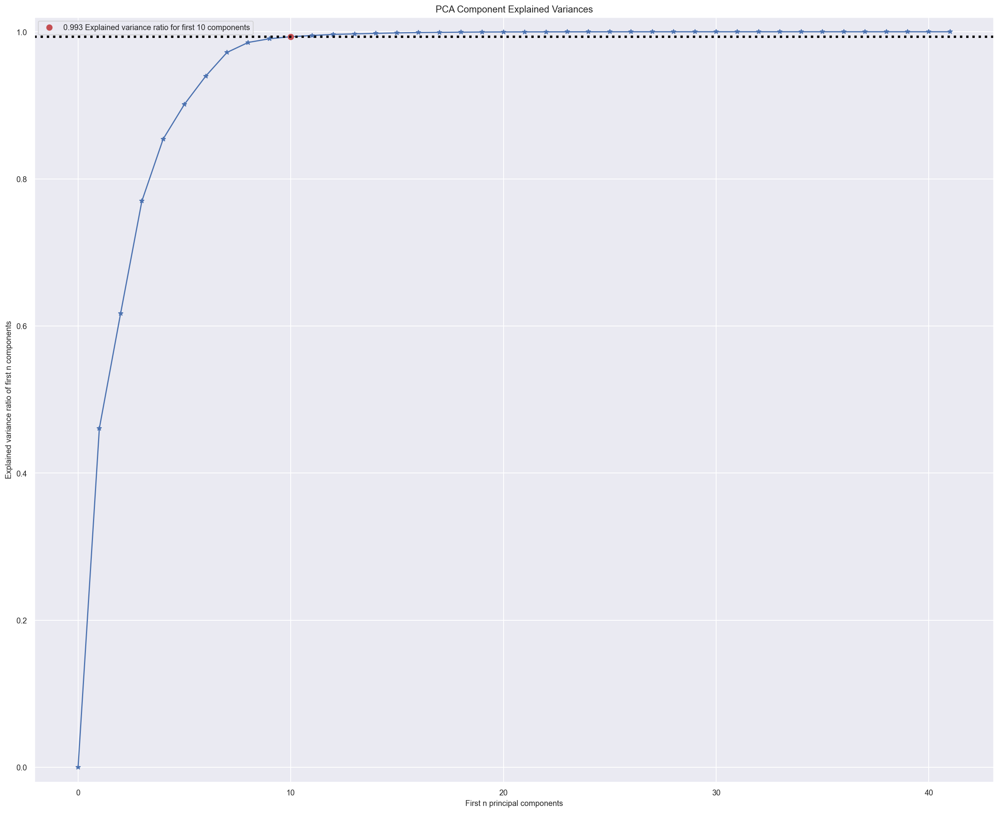

In [38]:
# plotting the 'elbow curve' for number of columns holding 99% of the variance of the data
plot_pca_component_variance(pca, target_explained_variance=0.992, figsize=(22, 18))
plt.show() 

Here we can see 99.3% of the variance can be found in the first 10 columns.

In [39]:
# Showing first 10 columns with eigenvals
demo_pcs.head(1).T[0:10]

,0
year,249.954942
month,2.009192
day,27.676970
extended,2.954369
country,13.250890
region,43.826453
vicinity,64.669585
crit1,-9.762229
crit2,-0.603088
crit3,-0.447975


In [40]:
var_eigenvals = pca.explained_variance_
var_pct = pca.explained_variance_ratio_

print('eigenvalues:\n', var_eigenvals, '\n')
print('explained variance pct:\n', var_pct)

eigenvalues:
 [5.16558431e+04 1.75172182e+04 1.71173114e+04 9.44650524e+03
 5.28855827e+03 4.29096408e+03 3.61465701e+03 1.52184223e+03
 5.63018917e+02 3.10258206e+02 1.83251566e+02 1.71232827e+02
 7.87440486e+01 7.52067980e+01 7.37974751e+01 5.14999928e+01
 3.07668710e+01 2.76572649e+01 2.04032484e+01 1.10243100e+01
 7.70089222e+00 4.76817058e+00 4.66816798e+00 3.61521731e+00
 3.01217403e+00 1.82521316e+00 1.29192172e+00 1.01726180e+00
 2.97533389e-01 2.66588733e-01 2.07830627e-01 1.31439212e-01
 1.03106901e-01 7.83851032e-02 7.36313647e-02 4.52799982e-02
 4.10181820e-02 3.39674058e-02 4.11894959e-03 3.24638482e-03
 1.23383736e-03] 

explained variance pct:
 [4.60888011e-01 1.56293564e-01 1.52725483e-01 8.42843858e-02
 4.71860094e-02 3.82851925e-02 3.22509900e-02 1.35783059e-02
 5.02341367e-03 2.76821128e-03 1.63502219e-03 1.52778761e-03
 7.02576625e-04 6.71016277e-04 6.58441901e-04 4.59497470e-04
 2.74510706e-04 2.46765923e-04 1.82043540e-04 9.83620048e-05
 6.87095338e-05 4.25429636e

In [41]:
pd.DataFrame(np.corrcoef(X_pca.T))

,0,1,2,3,4,5,6,7,8,9,...,31,32,33,34,35,36,37,38,39,40
0,1.000000e+00,-6.833956e-17,-1.080207e-16,-1.257782e-16,4.858432e-17,5.177959e-17,1.410401e-17,-7.788941e-17,-1.637932e-17,1.386559e-16,...,1.979546e-17,3.954292e-17,-6.630257e-17,1.576722e-17,-2.853805e-17,-2.996269e-17,2.785714e-16,5.376153e-19,2.422283e-18,-1.399751e-17
1,-6.833956e-17,1.000000e+00,-1.187173e-16,-2.347168e-16,-1.860494e-16,1.333758e-16,-4.036625e-18,7.154264e-17,5.673340e-17,8.525218e-17,...,5.229733e-18,1.771411e-17,-4.655838e-18,1.310122e-18,-2.338935e-17,1.301859e-17,3.729227e-17,1.089383e-16,-8.103916e-19,-5.271243e-17
2,-1.080207e-16,-1.187173e-16,1.000000e+00,-2.020790e-17,-7.427126e-17,3.597995e-16,2.940124e-16,7.198020e-17,2.069356e-17,-4.007218e-17,...,-4.496900e-17,1.941316e-17,-3.082851e-17,-1.502050e-17,-7.886996e-18,1.420561e-17,-2.549715e-16,6.304016e-18,-5.325640e-18,3.156818e-17
3,-1.257782e-16,-2.347168e-16,-2.020790e-17,1.000000e+00,-7.498324e-17,-8.576704e-17,1.044405e-16,-1.784325e-16,1.838926e-17,3.576573e-17,...,8.901977e-18,4.849561e-17,-5.619618e-17,1.932729e-17,-3.412544e-18,2.776231e-18,3.721146e-17,2.514350e-18,-7.213177e-18,-2.727681e-18
4,4.858432e-17,-1.860494e-16,-7.427126e-17,-7.498324e-17,1.000000e+00,1.293769e-16,-8.081184e-17,2.299823e-17,1.372829e-16,7.699044e-17,...,4.045129e-17,5.373188e-18,-2.002823e-17,-1.510108e-17,5.168957e-17,-3.620567e-17,-3.920121e-17,-6.046118e-17,-1.094152e-18,-2.887643e-17
5,5.177959e-17,1.333758e-16,3.597995e-16,-8.576704e-17,1.293769e-16,1.000000e+00,4.730440e-16,-1.579059e-16,1.356172e-17,-9.569476e-18,...,5.283292e-17,-6.710823e-17,1.453815e-17,-1.588248e-17,5.625925e-18,-2.955486e-18,-2.858042e-17,5.677575e-17,-4.202204e-18,3.024729e-17
6,1.410401e-17,-4.036625e-18,2.940124e-16,1.044405e-16,-8.081184e-17,4.730440e-16,1.000000e+00,-3.654888e-16,7.036221e-19,3.033118e-17,...,-6.044186e-17,0.000000e+00,6.708675e-17,6.489233e-18,-1.409826e-17,4.298868e-17,-7.077173e-17,-7.849939e-17,-1.344928e-17,5.569976e-18
7,-7.788941e-17,7.154264e-17,7.198020e-17,-1.784325e-16,2.299823e-17,-1.579059e-16,-3.654888e-16,1.000000e+00,6.438606e-17,1.400533e-16,...,6.653628e-17,1.721585e-17,-2.871990e-18,-1.852031e-19,-1.535111e-17,7.568179e-18,-1.090708e-17,1.494820e-17,4.851125e-18,4.005980e-17
8,-1.637932e-17,5.673340e-17,2.069356e-17,1.838926e-17,1.372829e-16,1.356172e-17,7.036221e-19,6.438606e-17,1.000000e+00,-1.621120e-17,...,-2.415719e-17,-1.476968e-16,1.837070e-16,1.108340e-16,6.989118e-17,-5.833792e-17,-1.513023e-17,-4.698970e-17,5.437939e-19,1.168749e-17
9,1.386559e-16,8.525218e-17,-4.007218e-17,3.576573e-17,7.699044e-17,-9.569476e-18,3.033118e-17,1.400533e-16,-1.621120e-17,1.000000e+00,...,6.416331e-17,-7.292110e-17,-2.278926e-16,-1.483688e-17,-4.687089e-17,5.621822e-17,1.136859e-16,-4.767811e-17,2.747043e-18,-5.458491e-18


In [42]:
np.allclose(np.corrcoef(X_pca.T), np.eye(len(X_pca.T)))

True

# Running PCA Transform on 10 Components 

In [43]:
from sklearn.decomposition import PCA

pca = PCA(n_components=10)
X_pca_ten = pca.fit_transform(chi)

In [44]:
X_pca_ten

array([[ 2.49954942e+02,  2.00919216e+00,  2.76769698e+01,
         2.95436853e+00,  1.32508897e+01,  4.38264525e+01,
         6.46695853e+01, -9.76222878e+00, -6.03087844e-01,
        -4.47974913e-01],
       [ 2.49951600e+02,  2.01050512e+00,  2.76634020e+01,
         2.97675079e+00,  1.32715318e+01,  4.38184434e+01,
         6.46499203e+01, -9.79222235e+00, -4.49905771e-01,
         2.31137209e-02],
       [ 2.53777392e+02, -1.68713844e+00,  6.88482831e+00,
         2.25722459e+00, -1.15119867e+01, -4.73824332e+01,
        -2.18004234e+01, -9.12269120e+00, -5.06290790e-01,
        -7.18906013e-01],
       [ 2.45555011e+02, -1.34547848e+01, -3.43080544e+01,
         5.67270484e+00, -6.81212078e+00, -2.65394383e+01,
        -6.39121373e+00, -1.04893684e+01, -4.76764873e-01,
        -4.27034593e-01],
       [ 3.23495538e+02,  1.07966522e+02,  3.90491335e+02,
        -3.74254761e+01, -3.92954862e+01, -7.71580801e+01,
        -1.15991615e+02, -1.33465799e+00,  2.48690872e-02,
         4.

In [101]:
# dataframe to show pca transformation to top 10 components
X_pcs = pd.DataFrame(pca.transform(chi), columns=chi.columns[:10])
X_pcs

,year,month,day,extended,country,region,vicinity,crit1,crit2,crit3
0,249.954942,2.009192,27.676970,2.954369,13.250890,43.826453,64.669585,-9.762229,-0.603088,-0.447975
1,249.951600,2.010505,27.663402,2.976751,13.271532,43.818443,64.649920,-9.792222,-0.449906,0.023114
2,253.777392,-1.687138,6.884828,2.257225,-11.511987,-47.382433,-21.800423,-9.122691,-0.506291,-0.718906
3,245.555011,-13.454785,-34.308054,5.672705,-6.812121,-26.539438,-6.391214,-10.489368,-0.476765,-0.427035
4,323.495538,107.966522,390.491335,-37.425476,-39.295486,-77.158080,-115.991615,-1.334658,0.024869,0.467570
...,...,...,...,...,...,...,...,...,...,...
57985,-194.270083,-52.578800,-15.148318,-74.772800,-25.397742,-34.120092,20.639192,1.175754,1.132486,-1.635493
57986,-222.381770,-20.973738,265.735818,231.743320,-15.370595,145.943536,155.432223,1.170169,2.163332,-1.406732
57987,-212.449136,-85.127576,-134.964689,-67.325396,-43.394373,-14.373415,-47.417503,-1.760174,0.641398,-2.114983
57988,-230.413744,-52.379789,145.473333,237.209871,-53.351873,-4.664360,21.316034,2.376209,2.213510,-2.193968


After setting the pca to 10 components we can see the ten columns with 99.3% of the variance of data. Of these 'Year' has the highest value so we would expect that to be of high feature importance in the modelling.

# Plotting Top 3 Components

In [113]:
import plotly.express as px

pca = PCA(n_components=3)
components = pca.fit_transform(chi)

total_var = pca.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=df['gname'],
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'Year', '1': 'Month', '2': 'Day'}
)
fig.show()

In the graph above we can interactively observe the differing attacks for each Terrorist Group and compare the values for each of the top 3 components which were 'Year', 'Month' and 'Day'.

This plot shows clusters of the terrorist groups based on their similarity, with groups such as the Taliban clustered in red with high values for year and negative values for month and day. and Muslim Extremists clustered in green which has negative values for year and day but positive values for month.

We can see the group as a whole leaning towards higher numbers for month and year with lower weighting being placed on day.